# Predict Customer Lifetime Value with Linear Regression
This project aims to develop a machine learning model using linear regression to predict the Customer Lifetime Value (CLTV). The concept and approach of the project are inspired by and partially based on methodologies and insights gained from an informative article titled "Predict Customer Lifetime Value with Machine Learning," published on Medium. This article, available at [this link](https://medium.com/swlh/predict-customer-lifetime-value-with-machine-learning-545624073d14), provides a comprehensive overview of the process and considerations involved in using machine learning techniques, specifically linear regression, for CLTV prediction.


--- 
### **1. Look the big picture**

Customer Lifetime Value (CLTV) is a pivotal metric in business dynamics, indicating the total amount a customer is likely to spend during their engagement with a company. This concept, extensively discussed in a Medium article titled "Predict Customer Lifetime Value with Machine Learning" ([read more here](https://medium.com/swlh/predict-customer-lifetime-value-with-machine-learning-545624073d14)), underlines its significance in strategizing customer acquisition and retention, thus influencing the Return on Investment (ROI) in marketing decisions. An optimized CLTV, when juxtaposed with acquisition costs, can substantially elevate business revenues.

Our project, drawing inspiration from the above article, simplifies the broader notion of CLTV to a more manageable scope. We will concentrate on predicting a customer's spending over the next three months, using this short-term estimate as a stand-in for their overall lifetime value. This narrowed focus is particularly relevant to the company's quarterly operational strategy, allowing for more immediate and actionable business insights.

By utilizing historical transaction data and employing linear regression methods, our goal is to build a predictive model that can accurately determine short-term customer spending. This endeavor is not just about enhancing current marketing and customer retention tactics; it's also about laying the groundwork for a deeper understanding of customer spending behaviors, thereby enriching long-term strategic planning and business intelligence.

### Objective

The project aims to develop a predictive model to accurately forecast individual customer spending within the next three months. Leveraging historical transaction data, this model is intended to guide and refine quarterly marketing and customer retention strategies, directly aligning with the business's operational goals.

### Model to Use
In this project, we will employ linear regression models. This decision is based on the suitability of linear regression for our dataset, which is expected to exhibit a linear relationship between the features and customer spending. Furthermore, this approach aligns with the educational goal of applying learned concepts in linear regression modeling. Linear regression offers a balance between simplicity and effectiveness, making it an ideal choice for predictive analysis in this context.

### Model Performance Measures

- **MSE (Mean Squared Error)**: Measures the average of the squares of the errors or deviations—that is, the difference between actual and estimated values. This metric will help us understand the magnitude of prediction errors, although it is sensitive to outliers.

- **MedAE (Median Absolute Error)**: Provides a robust measure of the median error magnitude, less sensitive to outliers compared to MSE. This metric is crucial for a more stable and reliable error assessment.

- **R-squared**: Reflects the proportion of the variance in the dependent variable that is predictable from the independent variables. It ranges from 0 to 1, with higher values indicating a better fit of the model to the data. This metric is essential to evaluate how well our model captures the variance in customer spending and will be key in assessing the overall effectiveness of the model.

### Consideration of Model Limitations

### Linear Regression Model Limitations

##### 1. Assumption of Linearity:
- Linear regression assumes a linear relationship between independent and dependent variables. However, customer spending behavior can be complex and influenced by non-linear factors, potentially leading to suboptimal predictions.

##### 2. Effect of Outliers:
- The model is sensitive to outliers. Extreme values in customer spending can disproportionately influence the model's predictions. The Median Absolute Error (MedAE) helps understand the central tendency, but outliers can still skew the Mean Squared Error (MSE).


---
### **2. Get the data**

The foundational data for this project originates from the UCI Machine Learning Repository ([Online Retail Dataset](https://archive.ics.uci.edu/dataset/352/online+retail)). However, for a more practical and real-world application, we will use anonymized and modified data from a confidential company, encompassing data from the past year. This approach ensures both the relevance and confidentiality of the data.

### Data Privacy and Anonymization
- To safeguard confidentiality and prevent data theft, sensitive information in the company dataset, such as customer codes and countries, will be altered or anonymized.
- All analysis will adhere to strict data privacy guidelines and the company's data usage policies to ensure compliance with data protection laws.

### Attribute Information
- **InvoiceNo**: Invoice number. UUID uniquely assigned to each transaction.
- **StockCode**: Product code. UUID uniquely assigned to each product.
- **Description**: Product name (altered for data protection).
- **Quantity**: Quantities of each product per transaction.
- **InvoiceDate**: Invoice date and time.
- **UnitPrice**: Product price per unit in sterling (dollars).
- **CustomerID**: Anonymized customer UUID to protect individual customer identities.
- **Country**: Country where the customer resides.



In [1]:
import pandas as pd
import numpy as np

# To visualize
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# Plotly
import plotly.express as px


In [2]:
df = pd.read_csv("../data/CLVT_project/CLVT_project.csv")
df.drop(df.columns[0], axis=1, inplace=True)
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'])
df = df.convert_dtypes()

In [3]:
df.shape

(822369, 8)

In [4]:
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,2423f71b-6003-4775-8bf0-dd765b86be06,75d6a848-35f5-48f5-9608-dd5f6146e049,Tapones,1,2023-05-01,1.533,f41155f2-70b8-4345-9d92-9c4e0a1eccf9,MEXICO
1,7a26864c-3d9a-4db7-8e21-ef671ea31cab,75d6a848-35f5-48f5-9608-dd5f6146e049,Tapones,1,2023-03-02,1.533,a22279e4-f964-4dc9-b6d6-e80fafe6464c,MEXICO
2,97d04124-7c3c-466d-9c3a-509ddc44c914,75d6a848-35f5-48f5-9608-dd5f6146e049,Tapones,1,2023-04-14,1.533,ab5fc734-7b33-4457-955b-82b8ccdf4134,MEXICO
3,4ef15a40-d72b-4b88-a067-717ab4ae12ee,75d6a848-35f5-48f5-9608-dd5f6146e049,Tapones,2,2023-03-07,1.533,8a7b7e76-95a3-496b-bae7-5a5e1b9fd3b6,MEXICO
4,9d10ee8e-8cdf-4e51-b290-d3cc923935c7,75d6a848-35f5-48f5-9608-dd5f6146e049,Tapones,1,2023-05-29,1.552,c02505be-cb35-41c2-ae40-949c98a3232b,MEXICO


In [5]:
# Creat total sales
df["Sales"] = df["Quantity"] * df["UnitPrice"]

In [6]:
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Sales
0,2423f71b-6003-4775-8bf0-dd765b86be06,75d6a848-35f5-48f5-9608-dd5f6146e049,Tapones,1,2023-05-01,1.533,f41155f2-70b8-4345-9d92-9c4e0a1eccf9,MEXICO,1.533
1,7a26864c-3d9a-4db7-8e21-ef671ea31cab,75d6a848-35f5-48f5-9608-dd5f6146e049,Tapones,1,2023-03-02,1.533,a22279e4-f964-4dc9-b6d6-e80fafe6464c,MEXICO,1.533
2,97d04124-7c3c-466d-9c3a-509ddc44c914,75d6a848-35f5-48f5-9608-dd5f6146e049,Tapones,1,2023-04-14,1.533,ab5fc734-7b33-4457-955b-82b8ccdf4134,MEXICO,1.533
3,4ef15a40-d72b-4b88-a067-717ab4ae12ee,75d6a848-35f5-48f5-9608-dd5f6146e049,Tapones,2,2023-03-07,1.533,8a7b7e76-95a3-496b-bae7-5a5e1b9fd3b6,MEXICO,3.066
4,9d10ee8e-8cdf-4e51-b290-d3cc923935c7,75d6a848-35f5-48f5-9608-dd5f6146e049,Tapones,1,2023-05-29,1.552,c02505be-cb35-41c2-ae40-949c98a3232b,MEXICO,1.552


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 822369 entries, 0 to 822368
Data columns (total 9 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   InvoiceNo    822369 non-null  string        
 1   StockCode    822369 non-null  string        
 2   Description  822369 non-null  string        
 3   Quantity     822369 non-null  Int64         
 4   InvoiceDate  822369 non-null  datetime64[ns]
 5   UnitPrice    822369 non-null  Float64       
 6   CustomerID   822369 non-null  string        
 7   Country      822369 non-null  string        
 8   Sales        822369 non-null  Float64       
dtypes: Float64(2), Int64(1), datetime64[ns](1), string(5)
memory usage: 58.8 MB


In [8]:
df.describe().transpose()

,count,mean,min,25%,50%,75%,max,std
Quantity,822369.0,12.902139,1.0,2.0,3.0,10.0,22928.0,73.579033
InvoiceDate,822369,2022-12-10 11:39:33.975186176,2022-07-01 00:00:00,2022-09-13 00:00:00,2022-11-28 00:00:00,2023-03-04 00:00:00,2023-06-30 00:00:00,NaN
UnitPrice,822369.0,14.818282,0.0,0.6,2.0365,5.6015,6521.739,93.200143
Sales,822369.0,58.756319,0.0,2.402174,7.132075,25.663139,65264.650384,361.248034


---
## **3. Explore and visualize the data to gain insights**

In [9]:
# Information found after making firsts visualizations

# Median in this case gives a better picture
# There are several sales in 0, this will delete
# If it will posible add the time the client has stay since its register


df = df[(df["Sales"] > 0) & (df["Quantity"] > 0)]

In [10]:
# after the check we realize that there are several outliers so this outliers will be deleted

# Assuming df is your DataFrame and 'column_name' is your column of interest
Q1 = df['Sales'].quantile(0.25)
Q3 = df['Sales'].quantile(0.75)
IQR = Q3 - Q1

# Define bounds for the outliers
lower_bound = Q1 - 3 * IQR
upper_bound = Q3 + 3 * IQR

print(lower_bound)
print(upper_bound)


df = df[(df["Sales"] > lower_bound) & (df["Sales"] < upper_bound)]

-74.067830188
106.659622641


In [11]:
print(f"Number of rows with quantity less o equal to zero: {(df['Quantity'] <= 0).sum()}")
print(f"Number of rows with Unitprice less o equal to zero: {(df['UnitPrice'] <= 0).sum()}")
print('Number of missing values in the dataset:', df.isnull().sum().sum())
print('Percentage of missing values in the dataset:', df.isnull().sum().sum()*100/(df.shape[0]*df.shape[1]))
print("Number of missing values in 'Description' column:", df['Description'].isnull().sum())
print("Percentage of missing values in 'Description' column:", df['Description'].isnull().sum()*100/df.shape[0])
print("Number of missing values in 'CustomerID' column:", df['CustomerID'].isnull().sum())
print("Percentage of missing values in 'CustomerID' column:", df['CustomerID'].isnull().sum()*100/df.shape[0])

Number of rows with quantity less o equal to zero: 0
Number of rows with Unitprice less o equal to zero: 0
Number of missing values in the dataset: 0
Percentage of missing values in the dataset: 0.0
Number of missing values in 'Description' column: 0
Percentage of missing values in 'Description' column: 0.0
Number of missing values in 'CustomerID' column: 0
Percentage of missing values in 'CustomerID' column: 0.0


In [12]:
# Check the number of duplicated values
df.duplicated().sum().sum()

np.int64(0)

In [13]:
df.isnull().sum()

InvoiceNo      0
StockCode      0
Description    0
Quantity       0
InvoiceDate    0
UnitPrice      0
CustomerID     0
Country        0
Sales          0
dtype: int64

### General info

In [14]:
print("Number of unique customers:", df['CustomerID'].nunique())
print("Number of purchases:", df['InvoiceNo'].nunique())
print(f"Period of time. Min: {df['InvoiceDate'].min()} Max: {df['InvoiceDate'].max()}")
print("Number of unique countries:", df["Country"].nunique())

Number of unique customers: 18202
Number of purchases: 192281
Period of time. Min: 2022-07-01 00:00:00 Max: 2023-06-30 00:00:00
Number of unique countries: 3


### Products info

In [15]:
df['UnitPrice'].describe(percentiles=[.99])

count     679639.0
mean      6.233833
std      11.484966
min       0.000217
50%       2.117283
99%         58.185
max        106.306
Name: UnitPrice, dtype: Float64

In [16]:
bins=20
fig = px.histogram(df[df["UnitPrice"] <=132.758], x='UnitPrice', nbins=bins)
fig.update_xaxes(nticks=bins)
fig.update_layout(
    title_text='Unit price distribution', # title of plot
    xaxis_title_text='Unit price', # xaxis label
    yaxis_title_text='Count', # yaxis label
    bargap=0.01, # gap between bars of adjacent location coordinates
    bargroupgap=0.01 # gap between bars of the same location coordinates
)

fig.update_layout(
        paper_bgcolor='white',
        plot_bgcolor='white',
    )
fig.show()

### Quantity info

In [17]:
df['Quantity'].describe(percentiles=[.99])

count     679639.0
mean      6.870225
std      14.117058
min            1.0
50%            3.0
99%           50.0
max         1108.0
Name: Quantity, dtype: Float64

In [18]:
bins=50
fig = px.histogram(df[df["Quantity"] <=150], x='Quantity', nbins=bins)
fig.update_xaxes(nticks=bins)
fig.update_layout(
    title_text='Distribution of quantity of products', # title of plot
    xaxis_title_text='Quantity', # xaxis label
    yaxis_title_text='Count', # yaxis label
    bargap=0.01, # gap between bars of adjacent location coordinates
    bargroupgap=0.01 # gap between bars of the same location coordinates
)

fig.update_layout(
        paper_bgcolor='white',
        plot_bgcolor='white',
    
)
fig.show()

### Sales info

In [19]:
df['Sales'].describe(percentiles=[.75])

count      679639.0
mean       16.14746
std       20.931388
min        0.000217
50%        7.298141
75%       19.884782
max      106.643694
Name: Sales, dtype: Float64

In [20]:
grouped_df = df.groupby([df['InvoiceDate'].dt.to_period('M'), 'Country']).agg(
    {
        "Sales": "sum"
    }).reset_index()
grouped_df['InvoiceDate'] = grouped_df['InvoiceDate'].dt.to_timestamp()
# Now use Plotly Express to create the line plot
fig = px.line(grouped_df, x='InvoiceDate', y='Sales', color='Country', markers=True, title='Sales per Month by Country Over Time')

fig.update_layout(
        paper_bgcolor='white',
        plot_bgcolor='white',
    )

# Show the plot
fig.show()

In [21]:
grouped_df = df.groupby([df['InvoiceDate'].dt.to_period('M'), 'Country']).agg(
    {
        "Sales": "mean"
    }).reset_index()
grouped_df['InvoiceDate'] = grouped_df['InvoiceDate'].dt.to_timestamp()
# Now use Plotly Express to create the line plot
fig = px.line(grouped_df, x='InvoiceDate', y='Sales', color='Country', markers=True, title='Mean Sales per Month by Country Over Time')

fig.update_layout(
        paper_bgcolor='white',
        plot_bgcolor='white',
    )

# Show the plot
fig.show()

In [22]:
grouped_df = df.groupby([df['InvoiceDate'].dt.to_period('M'), 'Country']).agg(
    {
        "Sales": "median"
    }).reset_index()
grouped_df['InvoiceDate'] = grouped_df['InvoiceDate'].dt.to_timestamp()
# Now use Plotly Express to create the line plot
fig = px.box(grouped_df, x='Country', y='Sales', title='Median Sales by Country')

fig.update_layout(
        paper_bgcolor='white',
        plot_bgcolor='white',
    )

# Show the plot
fig.show()

In [23]:
grouped_df = df.groupby([df['InvoiceDate'].dt.to_period('M'), 'Country']).agg(
    {
        "Sales": "median"
    }).reset_index()
grouped_df['InvoiceDate'] = grouped_df['InvoiceDate'].dt.to_timestamp()
# Now use Plotly Express to create the line plot
fig = px.line(grouped_df, x='InvoiceDate', y='Sales', color='Country', markers=True, title='Median Sales per Month by Country Over Time')

fig.update_layout(
        paper_bgcolor='white',
        plot_bgcolor='white',
    )

# Show the plot
fig.show()

In [24]:
grouped_df = df.groupby(['Country', pd.Grouper(key="InvoiceDate", freq='3M')]).agg(
    {
        "Sales": "median"
    }).reset_index()
# grouped_df['InvoiceDate'] = grouped_df['InvoiceDate'].dt.to_timestamp()
# Now use Plotly Express to create the line plot
fig = px.line(grouped_df, x='InvoiceDate', y='Sales', color='Country', markers=True, title='Median Sales per 3 Month by Country Over Time')

fig.update_layout(
        paper_bgcolor='white',
        plot_bgcolor='white',
    )

# Show the plot
fig.show()




C:\Users\david\AppData\Local\Temp\ipykernel_10084\3928280089.py:1: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



In [25]:
grouped_df = df.groupby(['Country', pd.Grouper(key="InvoiceDate", freq='3M')]).agg(
    {
        "Sales": "sum"
    }).reset_index()
# grouped_df['InvoiceDate'] = grouped_df['InvoiceDate'].dt.to_timestamp()
# Now use Plotly Express to create the line plot
fig = px.line(grouped_df, x='InvoiceDate', y='Sales', color='Country', markers=True, title='Sum Sales per 3 Month by Country Over Time')

fig.update_layout(
        paper_bgcolor='white',
        plot_bgcolor='white',
    )

# Show the plot
fig.show()


C:\Users\david\AppData\Local\Temp\ipykernel_10084\3334320813.py:1: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



In [26]:
grouped_df = df.groupby(by=["Country"]).agg({
    "Sales": "sum"
}).reset_index()
fig = px.pie(grouped_df, names='Country', values='Sales', title="Sales percentage by country")
fig.show()

In [27]:
# sns.pairplot(df)

### Summary of sales

In [28]:
# Create a dataframe with orders

df_orders = df.groupby(by=["CustomerID", "InvoiceNo"]).agg(
    {"Sales": "sum",
     "InvoiceDate": "max"
     })

In [29]:
# Let's estimate the frequency, recency, and 
# total amount of purchases by each customer

def groupby_mean(x):
    return x.mean 

def groupby_count(x):
    return x.count 

def purchase_duration(x):
    """How many days the person has been purchasing in days
    x = dates"""
    return (x.max() - x.min()).days

def avg_frecuency(x):
    return (x.max() - x.min()).days / x.count()


groupby_mean.__name__ = "avg"
groupby_count.__name__ = "count"
purchase_duration.__name__ = "purchase_duration"
avg_frecuency.__name__ = "purchase_frequency"


In [30]:
df_summary = df_orders.reset_index().groupby("CustomerID").agg({
    "Sales": ["min", "max", "sum", "mean", "count"],
    "InvoiceDate": ["min", "max", purchase_duration, avg_frecuency]
})

df_summary.columns = ["_".join(col).lower() for col in df_summary.columns]

df_summary = df_summary.loc[df_summary["invoicedate_purchase_duration"] > 0]


In [31]:
df_summary.head()

,sales_min,sales_max,sales_sum,sales_mean,sales_count,invoicedate_min,invoicedate_max,invoicedate_purchase_duration,invoicedate_purchase_frequency
CustomerID,,,,,,,,,
00022873-834d-47b3-82c9-472c3aeeab36,4.482,83.324,93.7235,31.241167,3,2023-05-30,2023-06-29,30,10.00
00039af4-d666-40fc-9c1f-2a0bb03da418,13.6025,43.319,56.9215,28.46075,2,2022-07-25,2023-03-13,231,115.50
0004cefa-411e-4d53-8c01-4c800a8f6c37,52.082347,98.282607,299.270385,74.817596,4,2022-07-19,2022-10-15,88,22.00
000b1df8-ccaf-492b-bbec-795a86f9d758,31.056086,31.056086,62.112173,31.056086,2,2022-08-11,2022-08-25,14,7.00
000c7e38-aaa7-46d8-9b4d-fce1d508f7de,24.136363,81.900651,174.45396,43.61349,4,2022-11-08,2023-04-18,161,40.25


In [32]:
grouped_df = df_summary.groupby('sales_count').count()['sales_mean'][:20].reset_index()
fig = px.bar(
    grouped_df, x='sales_count', y='sales_mean',
    labels={'sales_count': 'Sales count', 'sales_mean':'Number of customers'},
    title="Number of purchases made by repeat customers")
fig.update_xaxes(nticks=len(grouped_df["sales_count"]) * 2)
fig.update_layout(
        paper_bgcolor='white',
        plot_bgcolor='white',
    )
fig.show()


In [33]:
fig = px.histogram(
    df_summary, x='invoicedate_purchase_frequency', nbins=20)

fig.update_xaxes(nticks=20)
fig.update_layout(
    title_text='Frequency of purchases made by repeat customers', # title of plot
    xaxis_title_text='Avearge number of days between purchases', # xaxis label
    yaxis_title_text='Number of customers', # yaxis label
    bargap=0.01, # gap between bars of adjacent location coordinates
    bargroupgap=0.01 # gap between bars of the same location coordinates
)

fig.update_layout(
        paper_bgcolor='white',
        plot_bgcolor='white',
    )
fig.show()

---
## **4. Prepare the data for machine learning algorithms**


In [34]:
df_orders.head(2)

Sales  \
CustomerID                           InvoiceNo                                      
00022873-834d-47b3-82c9-472c3aeeab36 5745ce08-53d7-4431-b362-59e51fe4018a  5.9175   
                                     6e25ba77-fae7-4eba-b0b5-a77497db9a3e   4.482   

                                                                          InvoiceDate  
CustomerID                           InvoiceNo                                         
00022873-834d-47b3-82c9-472c3aeeab36 5745ce08-53d7-4431-b362-59e51fe4018a  2023-05-30  
                                     6e25ba77-fae7-4eba-b0b5-a77497db9a3e  2023-06-29

In [35]:
# Let's slice the data into chunks with 3-month data each 
# and take the last chunk as the target for predictions
clv_freq = "3M"
df_data = df_orders.reset_index().groupby(
    ["CustomerID", pd.Grouper(key="InvoiceDate", freq=clv_freq)]).agg(
        {"Sales": ["sum", "mean", "count"]}
)

df_data.columns = ['_'.join(col).lower() for col in df_data.columns]
df_data = df_data.reset_index()

C:\Users\david\AppData\Local\Temp\ipykernel_10084\3157344370.py:5: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



In [36]:
df_data.head()

,CustomerID,InvoiceDate,sales_sum,sales_mean,sales_count
0,00022873-834d-47b3-82c9-472c3aeeab36,2023-07-31,93.7235,31.241167,3
1,00039af4-d666-40fc-9c1f-2a0bb03da418,2022-07-31,13.6025,13.6025,1
2,00039af4-d666-40fc-9c1f-2a0bb03da418,2023-04-30,43.319,43.319,1
3,0004cefa-411e-4d53-8c01-4c800a8f6c37,2022-07-31,98.282607,98.282607,1
4,0004cefa-411e-4d53-8c01-4c800a8f6c37,2022-10-31,200.987779,66.995926,3


In [37]:
map_date_month = {str(x)[:10]: 'M_%s' % (i+1) for i, x in enumerate(
                    sorted(df_data.reset_index()['InvoiceDate'].unique(), reverse=False))}
df_data['M'] = df_data['InvoiceDate'].apply(lambda x: map_date_month[str(x)[:10]])
df_data.head()

,CustomerID,InvoiceDate,sales_sum,sales_mean,sales_count,M
0,00022873-834d-47b3-82c9-472c3aeeab36,2023-07-31,93.7235,31.241167,3,M_5
1,00039af4-d666-40fc-9c1f-2a0bb03da418,2022-07-31,13.6025,13.6025,1,M_1
2,00039af4-d666-40fc-9c1f-2a0bb03da418,2023-04-30,43.319,43.319,1,M_4
3,0004cefa-411e-4d53-8c01-4c800a8f6c37,2022-07-31,98.282607,98.282607,1,M_1
4,0004cefa-411e-4d53-8c01-4c800a8f6c37,2022-10-31,200.987779,66.995926,3,M_2


In [38]:
map_date_month

{'2022-07-31': 'M_1',
 '2022-10-31': 'M_2',
 '2023-01-31': 'M_3',
 '2023-04-30': 'M_4',
 '2023-07-31': 'M_5'}

In [39]:
# Number of purchases made in each chunk
df_data['M'].value_counts()

M
M_2    12006
M_3     9225
M_1     9056
M_4     9051
M_5     8949
Name: count, dtype: int64

### Features

In [40]:
# make features
df_features = pd.pivot_table(
    data=df_data.loc[df_data["M"] != "M_5"],
    values=["sales_sum", "sales_mean", "sales_count"],
    columns="M",
    index="CustomerID")
df_features.reset_index()
df_features.columns = ['_'.join(col) for col in df_features.columns]

In [41]:
df_features.head()

,sales_count_M_1,sales_count_M_2,sales_count_M_3,sales_count_M_4,sales_mean_M_1,sales_mean_M_2,sales_mean_M_3,sales_mean_M_4,sales_sum_M_1,sales_sum_M_2,sales_sum_M_3,sales_sum_M_4
CustomerID,,,,,,,,,,,,
00039af4-d666-40fc-9c1f-2a0bb03da418,1.0,<NA>,<NA>,1.0,13.6025,<NA>,<NA>,43.319,13.6025,<NA>,<NA>,43.319
0004cefa-411e-4d53-8c01-4c800a8f6c37,1.0,3.0,<NA>,<NA>,98.282607,66.995926,<NA>,<NA>,98.282607,200.987779,<NA>,<NA>
000b1df8-ccaf-492b-bbec-795a86f9d758,<NA>,2.0,<NA>,<NA>,<NA>,31.056086,<NA>,<NA>,<NA>,62.112173,<NA>,<NA>
000c7e38-aaa7-46d8-9b4d-fce1d508f7de,<NA>,<NA>,2.0,2.0,<NA>,<NA>,55.740597,31.486383,<NA>,<NA>,111.481193,62.972766
000caed1-fc2f-4a60-a8ed-b9bcf110333e,<NA>,<NA>,<NA>,1.0,<NA>,<NA>,<NA>,43.850943,<NA>,<NA>,<NA>,43.850943


In [42]:
df_features.reset_index(level=0, inplace=True)

In [43]:
df_features.head(10)

,CustomerID,sales_count_M_1,sales_count_M_2,sales_count_M_3,sales_count_M_4,sales_mean_M_1,sales_mean_M_2,sales_mean_M_3,sales_mean_M_4,sales_sum_M_1,sales_sum_M_2,sales_sum_M_3,sales_sum_M_4
0,00039af4-d666-40fc-9c1f-2a0bb03da418,1.0,<NA>,<NA>,1.0,13.6025,<NA>,<NA>,43.319,13.6025,<NA>,<NA>,43.319
1,0004cefa-411e-4d53-8c01-4c800a8f6c37,1.0,3.0,<NA>,<NA>,98.282607,66.995926,<NA>,<NA>,98.282607,200.987779,<NA>,<NA>
2,000b1df8-ccaf-492b-bbec-795a86f9d758,<NA>,2.0,<NA>,<NA>,<NA>,31.056086,<NA>,<NA>,<NA>,62.112173,<NA>,<NA>
3,000c7e38-aaa7-46d8-9b4d-fce1d508f7de,<NA>,<NA>,2.0,2.0,<NA>,<NA>,55.740597,31.486383,<NA>,<NA>,111.481193,62.972766
4,000caed1-fc2f-4a60-a8ed-b9bcf110333e,<NA>,<NA>,<NA>,1.0,<NA>,<NA>,<NA>,43.850943,<NA>,<NA>,<NA>,43.850943
5,000d1f71-5427-45d5-a82c-b754eff8540c,<NA>,1.0,<NA>,<NA>,<NA>,275.250268,<NA>,<NA>,<NA>,275.250268,<NA>,<NA>
6,00173ac2-cbe1-45d1-8af2-2e15dac538d1,1.0,<NA>,<NA>,<NA>,29.8015,<NA>,<NA>,<NA>,29.8015,<NA>,<NA>,<NA>
7,001eec76-1734-44de-b046-e54b78338e34,<NA>,<NA>,<NA>,1.0,<NA>,<NA>,<NA>,27.635849,<NA>,<NA>,<NA>,27.635849
8,0024453a-6e45-4bee-a9a9-984804af3af6,<NA>,4.0,<NA>,<NA>,<NA>,83.49848,<NA>,<NA>,<NA>,333.993919,<NA>,<NA>
9,002f7be1-cfc1-4fa5-8acf-21871e2524f7,<NA>,1.0,<NA>,<NA>,<NA>,2.334674,<NA>,<NA>,<NA>,2.334674,<NA>,<NA>


In [44]:
df_features.fillna(0, inplace=True)

In [45]:
# Let's check the Null values
df_features.isnull().sum().sum()

np.int64(0)

In [46]:
df_features.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16043 entries, 0 to 16042
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   CustomerID       16043 non-null  string 
 1   sales_count_M_1  16043 non-null  Float64
 2   sales_count_M_2  16043 non-null  Float64
 3   sales_count_M_3  16043 non-null  Float64
 4   sales_count_M_4  16043 non-null  Float64
 5   sales_mean_M_1   16043 non-null  Float64
 6   sales_mean_M_2   16043 non-null  Float64
 7   sales_mean_M_3   16043 non-null  Float64
 8   sales_mean_M_4   16043 non-null  Float64
 9   sales_sum_M_1    16043 non-null  Float64
 10  sales_sum_M_2    16043 non-null  Float64
 11  sales_sum_M_3    16043 non-null  Float64
 12  sales_sum_M_4    16043 non-null  Float64
dtypes: Float64(12), string(1)
memory usage: 1.8 MB


In [47]:
df_features.tail(5)

,CustomerID,sales_count_M_1,sales_count_M_2,sales_count_M_3,sales_count_M_4,sales_mean_M_1,sales_mean_M_2,sales_mean_M_3,sales_mean_M_4,sales_sum_M_1,sales_sum_M_2,sales_sum_M_3,sales_sum_M_4
16038,ffead7c5-a140-4e0f-a7fb-1b300d32d039,4.0,15.0,7.0,2.0,41.6695,54.222767,47.487071,77.14525,166.678,813.3415,332.4095,154.2905
16039,ffeb796e-f60b-428a-afb2-947fe455f2f2,9.0,18.0,14.0,4.0,71.849197,95.170778,98.472076,124.259321,646.64277,1713.073998,1378.609059,497.037286
16040,fffab57b-a3e0-49d8-926d-abaab345e541,0.0,0.0,0.0,8.0,0.0,0.0,0.0,72.97825,0.0,0.0,0.0,583.826
16041,fffc166c-98de-4e84-90ef-59847c8e0f98,0.0,0.0,0.0,2.0,0.0,0.0,0.0,81.065146,0.0,0.0,0.0,162.130292
16042,ffffa97c-ac29-4839-9edd-9ed47149b4e6,1.0,2.0,2.0,0.0,24.661956,61.328912,35.471306,0.0,24.661956,122.657824,70.942612,0.0


### Target

In [48]:
df_data.head(2)

,CustomerID,InvoiceDate,sales_sum,sales_mean,sales_count,M
0,00022873-834d-47b3-82c9-472c3aeeab36,2023-07-31,93.7235,31.241167,3,M_5
1,00039af4-d666-40fc-9c1f-2a0bb03da418,2022-07-31,13.6025,13.6025,1,M_1


In [49]:
df_target = df_data.loc[df_data["M"] == "M_5", ["CustomerID", "sales_sum"]]
df_target.columns = ["CustomerID", "CLV_" + clv_freq]

In [50]:
df_target.shape

(8949, 2)

In [51]:
df_target.head()

,CustomerID,CLV_3M
0,00022873-834d-47b3-82c9-472c3aeeab36,93.7235
9,000caed1-fc2f-4a60-a8ed-b9bcf110333e,112.45283
16,003029ae-3a03-4cdc-9ad3-51918eea7578,249.4715
17,003258e5-a416-46c1-9e4e-d28b6f7d6669,25.1745
23,003c217c-e94d-4dba-a250-6cb1a5348a05,127.305


### Sample

In [52]:
df_sample_set = df_features.merge(
    df_target,
    on="CustomerID",
    how="left"
)

In [53]:
df_sample_set.head()

,CustomerID,sales_count_M_1,sales_count_M_2,sales_count_M_3,sales_count_M_4,sales_mean_M_1,sales_mean_M_2,sales_mean_M_3,sales_mean_M_4,sales_sum_M_1,sales_sum_M_2,sales_sum_M_3,sales_sum_M_4,CLV_3M
0,00039af4-d666-40fc-9c1f-2a0bb03da418,1.0,0.0,0.0,1.0,13.6025,0.0,0.0,43.319,13.6025,0.0,0.0,43.319,<NA>
1,0004cefa-411e-4d53-8c01-4c800a8f6c37,1.0,3.0,0.0,0.0,98.282607,66.995926,0.0,0.0,98.282607,200.987779,0.0,0.0,<NA>
2,000b1df8-ccaf-492b-bbec-795a86f9d758,0.0,2.0,0.0,0.0,0.0,31.056086,0.0,0.0,0.0,62.112173,0.0,0.0,<NA>
3,000c7e38-aaa7-46d8-9b4d-fce1d508f7de,0.0,0.0,2.0,2.0,0.0,0.0,55.740597,31.486383,0.0,0.0,111.481193,62.972766,<NA>
4,000caed1-fc2f-4a60-a8ed-b9bcf110333e,0.0,0.0,0.0,1.0,0.0,0.0,0.0,43.850943,0.0,0.0,0.0,43.850943,112.45283


In [54]:
df_sample_set.fillna(0, inplace=True)

In [55]:
df_sample_set.head()

,CustomerID,sales_count_M_1,sales_count_M_2,sales_count_M_3,sales_count_M_4,sales_mean_M_1,sales_mean_M_2,sales_mean_M_3,sales_mean_M_4,sales_sum_M_1,sales_sum_M_2,sales_sum_M_3,sales_sum_M_4,CLV_3M
0,00039af4-d666-40fc-9c1f-2a0bb03da418,1.0,0.0,0.0,1.0,13.6025,0.0,0.0,43.319,13.6025,0.0,0.0,43.319,0.0
1,0004cefa-411e-4d53-8c01-4c800a8f6c37,1.0,3.0,0.0,0.0,98.282607,66.995926,0.0,0.0,98.282607,200.987779,0.0,0.0,0.0
2,000b1df8-ccaf-492b-bbec-795a86f9d758,0.0,2.0,0.0,0.0,0.0,31.056086,0.0,0.0,0.0,62.112173,0.0,0.0,0.0
3,000c7e38-aaa7-46d8-9b4d-fce1d508f7de,0.0,0.0,2.0,2.0,0.0,0.0,55.740597,31.486383,0.0,0.0,111.481193,62.972766,0.0
4,000caed1-fc2f-4a60-a8ed-b9bcf110333e,0.0,0.0,0.0,1.0,0.0,0.0,0.0,43.850943,0.0,0.0,0.0,43.850943,112.45283


In [56]:
df_sample_set['CLV_3M'].describe()

count        16043.0
mean       78.342954
std       182.479451
min              0.0
25%              0.0
50%              0.0
75%        81.115684
max      4548.598114
Name: CLV_3M, dtype: Float64

---
## **5. Select a model and train it**

### Build linear regression

In [57]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

In [58]:
target_var = "CLV_3M"

all_features = [x for x in df_sample_set.columns if x not in ["CustomerID", target_var]]

In [59]:
all_features

['sales_count_M_1',
 'sales_count_M_2',
 'sales_count_M_3',
 'sales_count_M_4',
 'sales_mean_M_1',
 'sales_mean_M_2',
 'sales_mean_M_3',
 'sales_mean_M_4',
 'sales_sum_M_1',
 'sales_sum_M_2',
 'sales_sum_M_3',
 'sales_sum_M_4']

In [60]:
df_sample_set

,CustomerID,sales_count_M_1,sales_count_M_2,sales_count_M_3,sales_count_M_4,sales_mean_M_1,sales_mean_M_2,sales_mean_M_3,sales_mean_M_4,sales_sum_M_1,sales_sum_M_2,sales_sum_M_3,sales_sum_M_4,CLV_3M
0,00039af4-d666-40fc-9c1f-2a0bb03da418,1.0,0.0,0.0,1.0,13.6025,0.0,0.0,43.319,13.6025,0.0,0.0,43.319,0.0
1,0004cefa-411e-4d53-8c01-4c800a8f6c37,1.0,3.0,0.0,0.0,98.282607,66.995926,0.0,0.0,98.282607,200.987779,0.0,0.0,0.0
2,000b1df8-ccaf-492b-bbec-795a86f9d758,0.0,2.0,0.0,0.0,0.0,31.056086,0.0,0.0,0.0,62.112173,0.0,0.0,0.0
3,000c7e38-aaa7-46d8-9b4d-fce1d508f7de,0.0,0.0,2.0,2.0,0.0,0.0,55.740597,31.486383,0.0,0.0,111.481193,62.972766,0.0
4,000caed1-fc2f-4a60-a8ed-b9bcf110333e,0.0,0.0,0.0,1.0,0.0,0.0,0.0,43.850943,0.0,0.0,0.0,43.850943,112.45283
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16038,ffead7c5-a140-4e0f-a7fb-1b300d32d039,4.0,15.0,7.0,2.0,41.6695,54.222767,47.487071,77.14525,166.678,813.3415,332.4095,154.2905,369.22
16039,ffeb796e-f60b-428a-afb2-947fe455f2f2,9.0,18.0,14.0,4.0,71.849197,95.170778,98.472076,124.259321,646.64277,1713.073998,1378.609059,497.037286,176.806736
16040,fffab57b-a3e0-49d8-926d-abaab345e541,0.0,0.0,0.0,8.0,0.0,0.0,0.0,72.97825,0.0,0.0,0.0,583.826,418.8695
16041,fffc166c-98de-4e84-90ef-59847c8e0f98,0.0,0.0,0.0,2.0,0.0,0.0,0.0,81.065146,0.0,0.0,0.0,162.130292,95.932546


In [61]:
X = df_sample_set[all_features]
y = df_sample_set[target_var]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.35, random_state=20)

In [62]:
lin_reg = LinearRegression(n_jobs=1)

In [63]:
lin_reg.fit(X_train, y_train)

LinearRegression(n_jobs=1)

In [64]:
lin_reg.intercept_

np.float64(9.607884472192382)

In [65]:
lin_reg.coef_

array([ 2.55940325, -0.37087063, -2.86002885,  3.17037832,  0.16209287,
        0.01560772,  0.07410817, -0.20496103, -0.07861389,  0.02867809,
        0.06487959,  0.42576306])

In [66]:
coef = pd.DataFrame(list(
    zip(all_features, lin_reg.coef_)
))
coef.columns = ['feature', 'coef']

In [67]:
coef

,feature,coef
0,sales_count_M_1,2.559403
1,sales_count_M_2,-0.370871
2,sales_count_M_3,-2.860029
3,sales_count_M_4,3.170378
4,sales_mean_M_1,0.162093
5,sales_mean_M_2,0.015608
6,sales_mean_M_3,0.074108
7,sales_mean_M_4,-0.204961
8,sales_sum_M_1,-0.078614
9,sales_sum_M_2,0.028678


---
## **6. Fine tunning**

In [68]:
from sklearn.metrics import r2_score, median_absolute_error
train_preds =  lin_reg.predict(X_train)
test_preds = lin_reg.predict(X_test)
print('R-Squared for Train set: %0.2f' % r2_score(y_true=y_train, y_pred=train_preds))
print('R-Squared for Test set: %0.2f' % r2_score(y_true=y_test, y_pred=test_preds))

R-Squared for Train set: 0.52
R-Squared for Test set: 0.55


In [69]:
print('MedAE for Train set: %0.2f' % median_absolute_error(y_true=y_train, y_pred=train_preds))
print('MedAE for Test set: %0.2f' % median_absolute_error(y_true=y_test, y_pred=test_preds))

MedAE for Train set: 26.50
MedAE for Test set: 25.96


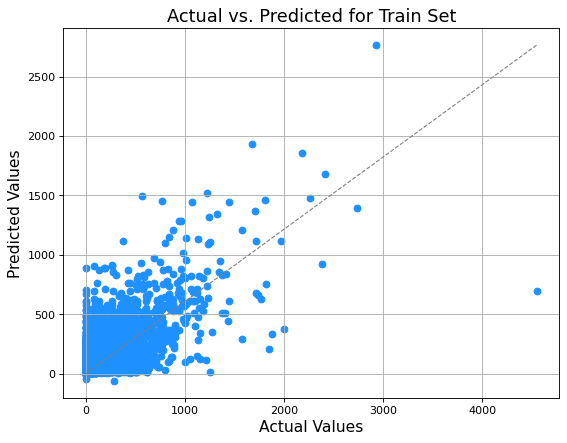

In [70]:
plt.figure(figsize=(8, 6), dpi=80)
plt.scatter(y_train, train_preds, color='dodgerblue')
plt.plot([0, max(y_train)], [0, max(train_preds)], color='gray', lw=1, linestyle='--')

plt.xlabel('Actual Values', fontsize=14)
plt.ylabel('Predicted Values', fontsize=14)
plt.title('Actual vs. Predicted for Train Set', fontsize=16)
plt.grid()

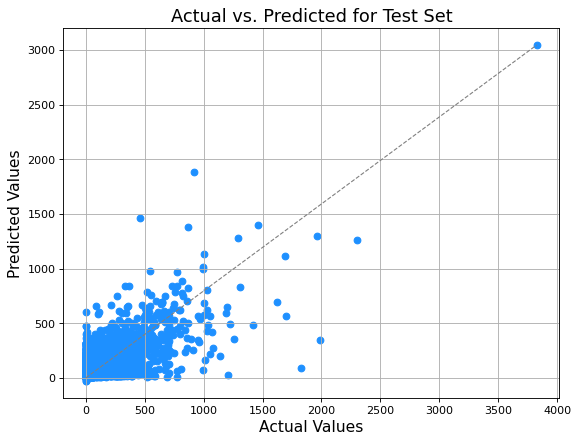

In [71]:
plt.figure(figsize=(8, 6), dpi=80)
plt.scatter(y_test, test_preds, color='dodgerblue')
plt.plot([0, max(y_test)], [0, max(test_preds)], color='gray', lw=1, linestyle='--')

plt.xlabel('Actual Values', fontsize=14)
plt.ylabel('Predicted Values', fontsize=14)
plt.title('Actual vs. Predicted for Test Set', fontsize=16)
plt.grid()

### The following code it designed to internalize the concepts of gradient descent, mini-batch gradient descent, stochastic gradient descend, learning curves & regularized linear models.

### General Cross Validation

In [72]:
from sklearn.model_selection import cross_validate, KFold
from sklearn.metrics import median_absolute_error, make_scorer, r2_score

kfold = KFold(n_splits=10, shuffle=True, random_state=42)

# Define multiple scoring metrics
scoring_metrics = {'r2': make_scorer(r2_score),
                   'med_ae': make_scorer(median_absolute_error)}

# Perform cross-validation with multiple scoring metrics
cv_results = cross_validate(lin_reg, X, y, cv=kfold, scoring=scoring_metrics)

# Print the R-squared score for each fold
print("R-squared scores for each fold:", cv_results['test_r2'])

# Print the mean R-squared across all folds
print("Mean R-squared across all folds:", cv_results['test_r2'].mean())

# Print the Median Absolute Error for each fold
print("Median Absolute Error scores for each fold:", cv_results['test_med_ae'])

# Print the mean Median Absolute Error across all folds
print("Mean Median Absolute Error across all folds:", cv_results['test_med_ae'].mean())


R-squared scores for each fold: [0.66541757 0.43288192 0.43191398 0.46576746 0.45200389 0.58110752
 0.58843172 0.53832067 0.53099173 0.57205033]
Mean R-squared across all folds: 0.5258886778055374
Median Absolute Error scores for each fold: [27.0408494  26.67036463 24.72976784 25.57754038 24.77578676 26.54061389
 27.3255896  24.27594294 25.733916   26.63939401]
Mean Median Absolute Error across all folds: 25.930976546116653


### Stochastic Gradient Descent

In [73]:
from sklearn.linear_model import SGDRegressor

kfold = KFold(n_splits=10, shuffle=True, random_state=42)

sgd_reg = SGDRegressor(max_iter=100000, tol=1e-5, penalty=None, eta0=0.001,
                       n_iter_no_change=100, random_state=42)

# Define multiple scoring metrics
scoring_metrics = {'r2': make_scorer(r2_score),
                   'med_ae': make_scorer(median_absolute_error)}

# Perform cross-validation with multiple scoring metrics
cv_results = cross_validate(sgd_reg, X, y, cv=kfold, scoring=scoring_metrics)

# Print the R-squared score for each fold
print("R-squared scores for each fold:", cv_results['test_r2'])

# Print the mean R-squared across all folds
print("Mean R-squared across all folds:", cv_results['test_r2'].mean())

# Print the Median Absolute Error for each fold
print("Median Absolute Error scores for each fold:", cv_results['test_med_ae'])

# Print the mean Median Absolute Error across all folds
print("Mean Median Absolute Error across all folds:", cv_results['test_med_ae'].mean())

R-squared scores for each fold: [-2.97457851e+21 -2.35576952e+20 -1.11872566e+22 -1.35736385e+21
 -1.02676062e+21 -3.92455970e+19 -1.17917035e+21 -3.58696735e+21
 -1.09004878e+22 -5.52672156e+20]
Mean R-squared across all folds: -3.304007974677512e+21
Median Absolute Error scores for each fold: [2.43931162e+12 9.37573977e+11 3.90750008e+12 1.08975793e+12
 9.83298274e+11 2.75259374e+11 1.03578823e+12 2.20834578e+12
 3.44295740e+12 1.02622515e+12]
Mean Median Absolute Error across all folds: 1734601781470.0396


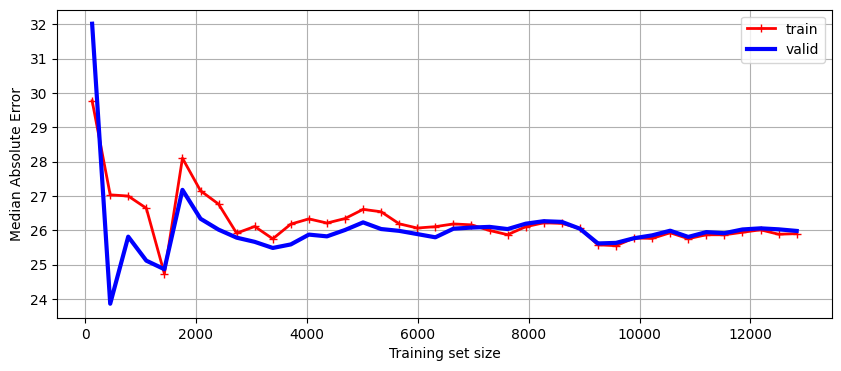

In [74]:
from sklearn.model_selection import learning_curve
from sklearn.linear_model import LinearRegression
import numpy as np
import matplotlib.pyplot as plt

# Original code with scoring changed to 'neg_median_absolute_error'
train_sizes, train_scores, valid_scores = learning_curve(
    LinearRegression(), X, y, train_sizes=np.linspace(0.01, 1.0, 40), cv=5,
    scoring="neg_median_absolute_error")

# Adjust the way errors are calculated (negate the scores as they are negative)
train_errors = -train_scores.mean(axis=1)
valid_errors = -valid_scores.mean(axis=1)

# Plotting (similar to your original code)
plt.figure(figsize=(10, 4))  # extra code – not needed, just formatting
plt.plot(train_sizes, train_errors, "r-+", linewidth=2, label="train")
plt.plot(train_sizes, valid_errors, "b-", linewidth=3, label="valid")

# Adjust labels to reflect the Median Absolute Error
plt.xlabel("Training set size")
plt.ylabel("Median Absolute Error")
plt.grid()
plt.legend(loc="upper right")

plt.show()

#### I will make some regularization, because:  "It is almost always preferable to have at least a little bit of regularization, so generally you should avoid plain linear regression"

### Ridge Regression

In [75]:
from sklearn.model_selection import cross_validate, KFold
from sklearn.metrics import median_absolute_error, make_scorer, r2_score
from sklearn.linear_model import Ridge  # Import Ridge

kfold = KFold(n_splits=10, shuffle=True, random_state=42)

# Define multiple scoring metrics
scoring_metrics = {'r2': make_scorer(r2_score),
                   'med_ae': make_scorer(median_absolute_error)}

# Create an instance of Ridge
ridge_reg = Ridge(alpha=0.1, solver="cholesky", random_state=42)  # You can set the alpha parameter here if needed

# Perform cross-validation with multiple scoring metrics using Ridge
cv_results = cross_validate(ridge_reg, X, y, cv=kfold, scoring=scoring_metrics)

# Print the R-squared score for each fold
print("R-squared scores for each fold:", cv_results['test_r2'])

# Print the mean R-squared across all folds
print("Mean R-squared across all folds:", cv_results['test_r2'].mean())

# Print the Median Absolute Error for each fold
print("Median Absolute Error scores for each fold:", cv_results['test_med_ae'])

# Print the mean Median Absolute Error across all folds
print("Mean Median Absolute Error across all folds:", cv_results['test_med_ae'].mean())


R-squared scores for each fold: [0.66541757 0.43288192 0.43191399 0.46576747 0.45200389 0.58110752
 0.58843171 0.53832067 0.53099172 0.57205034]
Mean R-squared across all folds: 0.5258886798239817
Median Absolute Error scores for each fold: [27.04084865 26.6703893  24.72977169 25.57754308 24.77578414 26.54061832
 27.32559967 24.27593312 25.73392706 26.63939741]
Mean Median Absolute Error across all folds: 25.930981245377108


### Lasso Regression

In [76]:
from sklearn.model_selection import cross_validate, KFold
from sklearn.metrics import median_absolute_error, make_scorer, r2_score
from sklearn.linear_model import Lasso  # Import Lasso

kfold = KFold(n_splits=10, shuffle=True, random_state=42)

# Define multiple scoring metrics
scoring_metrics = {'r2': make_scorer(r2_score),
                   'med_ae': make_scorer(median_absolute_error)}

# Create an instance of Lasso
lasso_reg = Lasso(alpha=0.1, random_state=42)  # You can set the alpha parameter here if needed

# Perform cross-validation with multiple scoring metrics using Lasso
cv_results = cross_validate(lasso_reg, X, y, cv=kfold, scoring=scoring_metrics)

# Print the R-squared score for each fold
print("R-squared scores for each fold:", cv_results['test_r2'])

# Print the mean R-squared across all folds
print("Mean R-squared across all folds:", cv_results['test_r2'].mean())

# Print the Median Absolute Error for each fold
print("Median Absolute Error scores for each fold:", cv_results['test_med_ae'])

# Print the mean Median Absolute Error across all folds
print("Mean Median Absolute Error across all folds:", cv_results['test_med_ae'].mean())


R-squared scores for each fold: [0.66540441 0.43288328 0.43196354 0.465786   0.45197409 0.58111007
 0.58837367 0.53836462 0.5309771  0.57211143]
Mean R-squared across all folds: 0.5258948211043112
Median Absolute Error scores for each fold: [27.02976225 26.93306338 24.75989599 25.59592364 24.78855328 26.59449003
 27.33222356 24.25570873 25.74759638 26.65374499]
Mean Median Absolute Error across all folds: 25.969096221406073


### Elastic Net Regression

In [77]:
from sklearn.model_selection import cross_validate, KFold
from sklearn.metrics import median_absolute_error, make_scorer, r2_score
from sklearn.linear_model import ElasticNet  # Import ElasticNet

kfold = KFold(n_splits=10, shuffle=True, random_state=42)

# Define multiple scoring metrics
scoring_metrics = {'r2': make_scorer(r2_score),
                   'med_ae': make_scorer(median_absolute_error)}

# Create an instance of ElasticNet
elastic_net_reg = ElasticNet(alpha=0.1, l1_ratio=0.5, random_state=42)  # You can set alpha and l1_ratio here if needed

# Perform cross-validation with multiple scoring metrics using ElasticNet
cv_results = cross_validate(elastic_net_reg, X, y, cv=kfold, scoring=scoring_metrics)

# Print the R-squared score for each fold
print("R-squared scores for each fold:", cv_results['test_r2'])

# Print the mean R-squared across all folds
print("Mean R-squared across all folds:", cv_results['test_r2'].mean())

# Print the Median Absolute Error for each fold
print("Median Absolute Error scores for each fold:", cv_results['test_med_ae'])

# Print the mean Median Absolute Error across all folds
print("Mean Median Absolute Error across all folds:", cv_results['test_med_ae'].mean())


R-squared scores for each fold: [0.66540716 0.43294108 0.43199005 0.46579738 0.45198129 0.58111808
 0.58833825 0.53835647 0.53097121 0.57214792]
Mean R-squared across all folds: 0.525904888512568
Median Absolute Error scores for each fold: [27.02279745 26.95087019 24.74395512 25.59268234 24.75435749 26.66959191
 27.33468007 24.23986817 25.71072804 26.70312248]
Mean Median Absolute Error across all folds: 25.972265327977187


---
## **7. Present your solution - Conclusions**

In [78]:
import pandas as pd
import plotly.graph_objects as go

# Assuming y_pred is a numpy array, convert it to a pandas DataFrame
y_pred_df = pd.DataFrame(test_preds, columns=['Predicted'])

# Ensure the indices match with y_test to align the data correctly
y_pred_df = y_pred_df.set_index(y_test.index)

# Create the scatter plot
scatter = go.Scatter(x=y_test.squeeze(), y=y_pred_df['Predicted'], mode='markers', name='Actual vs Predicted')

# Create the line for perfect predictions
line = go.Scatter(x=y_test.squeeze(), y=y_test.squeeze(), mode='lines', name='Perfect Fit')

# Create the figure and add the scatter plot and line
fig = go.Figure(data=[scatter, line])

# Update layout
fig.update_layout(title='Actual vs Predicted Values',
                  xaxis_title='Actual Values',
                  yaxis_title='Predicted Values',
                  xaxis=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
                  yaxis=dict(showline=True, linewidth=1, linecolor='black', mirror=True),
                  plot_bgcolor='white')

# Show the plot
fig.show()



In [79]:
y_test.mean()

np.float64(76.7475968854242)


### Conclusions

- **Model Selection**: The Linear Regression model emerged as the most fitting for our dataset, yielding an R-squared value of 55%. This indicates that approximately 55% of the variance in our target variable can be explained by the model.
  
- **Median Absolute Error**: We observed a Median Absolute Error (MedAE) of $25.96. Considering that the average sales sum per client over three months is $76, the error constitutes a significant portion of this amount. It suggests that while our model has predictive power, there is room for improvement, potentially through the exploration of alternative models or the inclusion of different features.
  
- **Outlier Impact**: The removal of outliers appears to have had a beneficial effect on the model's performance, enhancing its predictive accuracy.
  
- **Regularization Effects**: Contrary to expectations, regularization did not significantly enhance the model's performance. Only Ridge Regression showed a comparable performance to the best model, which is the standard Linear Regression.
  
- **Learning Outcomes**: This project has been instrumental in deepening our understanding of linear regression and its underlying principles.
  
- **Business Insight**: The model provides valuable insights for the marketing team by estimating the potential expenditure of a client. Such predictions can be pivotal in strategizing marketing efforts.
  
- **Statistical Significance**: For future projects involving linear regression, it will be crucial to consider the p-values to determine the statistical significance of the coefficients. This will help in identifying the features that have the most substantial impact on the target variable.
  
- **Exploration of Alternative Models**: In subsequent endeavors, especially those utilizing the same dataset, it would be prudent to evaluate other predictive models to refine our forecasts and achieve greater accuracy.
